# Prepare Google Colab Environment

In [1]:
# !git clone https://github.com/mhamilton723/STEGO.git

In [1]:
# !pip install wget
# !pip install torchmetrics
# !pip install hydra-core
# !pip install git+https://github.com/lucasb-eyer/pydensecrf.git
# !pip install omegaconf
# !pip install pytorch-lightning

# Download Pretrained Model



In [1]:
import os
from os.path import join

# os.chdir("STEGO/src")
saved_models_dir = join("..", "saved_models")
os.makedirs(saved_models_dir, exist_ok=True)

In [2]:
import wget
saved_model_url_root = "https://marhamilresearch4.blob.core.windows.net/stego-public/saved_models/"
saved_model_name = "cocostuff27_vit_base_5.ckpt"
if not os.path.exists(join(saved_models_dir, saved_model_name)):
  wget.download(saved_model_url_root + saved_model_name, join(saved_models_dir, saved_model_name))

# Load pretrained STEGO

In [3]:
from train_segmentation import LitUnsupervisedSegmenter

model = LitUnsupervisedSegmenter.load_from_checkpoint(join(saved_models_dir, saved_model_name)).cuda()

c:\Users\MLee27\Documents\Coding\Image_Segmentation\.venv\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\MLee27\Documents\Coding\Image_Segmentation\.venv\lib\site-packages\torchaudio\backend\utils.py:62: UserWarning: No audio backend is available.
  warnings.warn("No audio backend is available.")
c:\Users\MLee27\Documents\Coding\Image_Segmentation\Unsupervised_Seg\STEGO\src\train_segmentation.py:386: UserWarning: 
The version_base parameter is not specified.
Please specify a compatability version level, or None.
Will assume defaults for version 1.1
  @hydra.main(config_path="configs", config_name="train_config.yml")


Since no pretrained weights have been provided, we load the reference pretrained DINO weights.


# Load Image

In [4]:
from PIL import Image
import requests
from io import BytesIO
from torchvision.transforms.functional import to_tensor
from utils import get_transform

img_url ="https://marhamilresearch4.blob.core.windows.net/stego-public/sample_images/moto1.jpg"
response = requests.get(img_url)
img = Image.open(BytesIO(response.content))
transform = get_transform(448, False, "center")
img = transform(img).unsqueeze(0).cuda()

c:\Users\MLee27\Documents\Coding\Image_Segmentation\.venv\lib\site-packages\torchvision\transforms\transforms.py:329: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  warnings.warn(


In [5]:
## custom image
train_data = os.path.join('..','..','data' , 'stranger-sections-train', 'ara-train')
test_data =  os.path.join('..','..','data' , 'stranger-sections-test', 'ara-test')

input_img_paths = []
imgs = []

for dirname, _, filenames in os.walk(train_data):
    for filename in filenames:
        input_img_paths.append(os.path.join(dirname, filename))
        img = Image.open(os.path.join(dirname, filename))
        imgs.append(img)

In [6]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

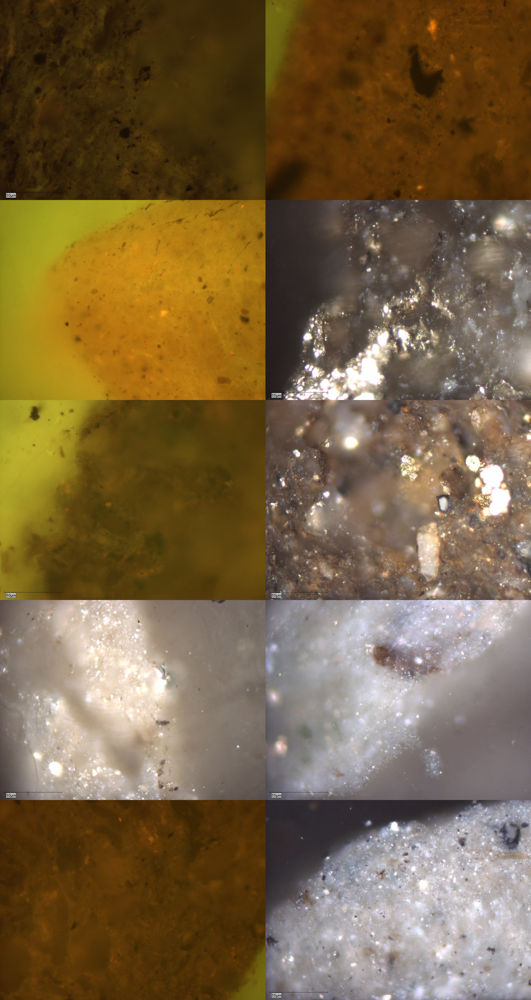

In [8]:
image_grid(imgs[10:20], 5,2)

In [9]:
img = Image.open(input_img_paths[20])
transform = get_transform(448, False, "center")
img = transform(img).unsqueeze(0).cuda()
img

tensor([[[[-1.1247, -1.1418, -1.1418,  ..., -1.3302, -1.3644, -1.2445],
          [-1.1075, -1.1247, -1.1418,  ..., -1.3473, -1.3302, -1.2959],
          [-1.0733, -1.1075, -1.1247,  ..., -1.2617, -1.3302, -1.1932],
          ...,
          [-1.2103, -1.2274, -1.2445,  ..., -1.4672, -1.4329, -1.4329],
          [-1.2445, -1.2617, -1.2788,  ..., -1.4672, -1.4329, -1.3987],
          [-1.2445, -1.2788, -1.3130,  ..., -1.4672, -1.4329, -1.3815]],

         [[-1.0903, -1.0553, -1.0728,  ..., -1.5455, -1.5280, -1.6506],
          [-1.0903, -1.0728, -1.0553,  ..., -1.5455, -1.5280, -1.5630],
          [-1.1078, -1.0728, -1.0728,  ..., -1.5630, -1.5280, -1.5455],
          ...,
          [-1.4405, -1.4755, -1.4930,  ..., -1.6856, -1.6681, -1.6681],
          [-1.4930, -1.5280, -1.5455,  ..., -1.6681, -1.6681, -1.6681],
          [-1.4930, -1.5455, -1.5805,  ..., -1.6681, -1.6506, -1.6681]],

         [[-1.5256, -1.5953, -1.5604,  ..., -1.6999, -1.6650, -1.7347],
          [-1.5256, -1.6302, -

# Query model and pass result through CRF

In [10]:
import torch.nn.functional as F
from crf import dense_crf
import torch

with torch.no_grad():
  code1 = model(img)
  code2 = model(img.flip(dims=[3]))
  code  = (code1 + code2.flip(dims=[3])) / 2
  code = F.interpolate(code, img.shape[-2:], mode='bilinear', align_corners=False)
  linear_probs = torch.log_softmax(model.linear_probe(code), dim=1).cpu()
  cluster_probs = model.cluster_probe(code, 2, log_probs=True).cpu()

  single_img = img[0].cpu()
  linear_pred = dense_crf(single_img, linear_probs[0]).argmax(0)
  cluster_pred = dense_crf(single_img, cluster_probs[0]).argmax(0)

# Visualize Result

Note that cluster predictions will not be matched with ground truth classes in this example. For hungarian matching please use: `eval_segmentation.py`

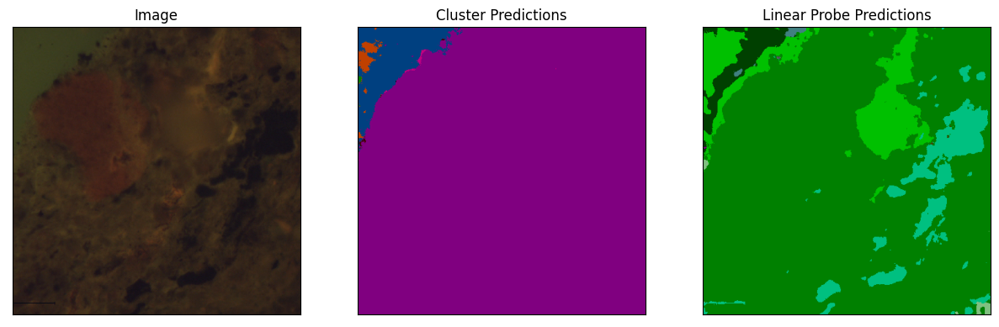

In [11]:
import matplotlib.pyplot as plt
from utils import unnorm, remove_axes
fig, ax = plt.subplots(1,3, figsize=(5*3,5))
ax[0].imshow(unnorm(img)[0].permute(1,2,0).cpu())
ax[0].set_title("Image")
ax[1].imshow(model.label_cmap[cluster_pred])
ax[1].set_title("Cluster Predictions")
ax[2].imshow(model.label_cmap[linear_pred])
ax[2].set_title("Linear Probe Predictions")
remove_axes(ax)